In [1]:
!pip install wandb

In [2]:
!pip install POT

In [3]:
!pip install seaborn

In [1]:
import os, sys
sys.path.append("..")

import matplotlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 

import numpy as np
import torch
import torch.nn as nn
import torchvision
import gc

from src import distributions
import torch.nn.functional as F

from src.resnet2 import ResNet_D
from src.unet import UNet

from src.tools import unfreeze, freeze
from src.tools import weights_init_D
from src.tools import load_dataset, get_pushed_loader_stats, get_pushed_loader_stats_from_latent
from src.fid_score import calculate_frechet_distance
from src.plotters import plot_random_images, plot_images, plot_random_images_from_latent, plot_images_from_latent

from copy import deepcopy
import json

from tqdm import tqdm_notebook as tqdm
from IPython.display import clear_output

import wandb # <--- online logging of the results
from src.tools import fig2data, fig2img # for wandb

# This needed to use dataloaders for some datasets
from PIL import PngImagePlugin
LARGE_ENOUGH_NUMBER = 100
PngImagePlugin.MAX_TEXT_CHUNK = LARGE_ENOUGH_NUMBER * (1024**2)

/home/user/conda/lib/python3.7/site-packages/librosa/core/constantq.py:1059: DeprecationWarning: `np.complex` is a deprecated alias for the builtin `complex`. To silence this warning, use `complex` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.complex128` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.complex,


In [2]:
DEVICE_IDS = [0]

#DATASET1, DATASET1_PATH = 'handbag', '../../data/handbag_128.hdf5'
#DATASET2, DATASET2_PATH = 'shoes', '../../data/shoes_128.hdf5'

DATASET2, DATASET2_PATH = 'celeba_female_tensor', '/home/jovyan/data/dataset/woman.pt'
DATASET1, DATASET1_PATH = 'celeba_male_tensor', '/home/jovyan/data/dataset/man.pt'
# DATASET2, DATASET2_PATH = 'aligned_anime_faces', '../../data/aligned_anime_faces'

T_ITERS = 10
f_LR, T_LR = 1e-4, 1e-4
IMG_SIZE = 512

BATCH_SIZE = 64

PLOT_INTERVAL = 250
COST = 'mse' # Mean Squared Error
CPKT_INTERVAL = 2000
MAX_STEPS = 100001
SEED = 0x000000

EXP_NAME = f'{DATASET1}_{DATASET2}_T{T_ITERS}_{COST}_{IMG_SIZE}'
OUTPUT_PATH = '../checkpoints_big_latent/{}/{}_{}_{}/'.format(COST, DATASET1, DATASET2, IMG_SIZE)

In [3]:
config = dict(
    DATASET1=DATASET1,
    DATASET2=DATASET2, 
    T_ITERS=T_ITERS,
    f_LR=f_LR, T_LR=T_LR,
    BATCH_SIZE=BATCH_SIZE
)
    
assert torch.cuda.is_available()
torch.cuda.set_device(f'cuda:{DEVICE_IDS[0]}')
torch.manual_seed(SEED); np.random.seed(SEED)

if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

In [4]:
filename = './stats/{}_{}_test.json'.format(DATASET2, IMG_SIZE)
with open(filename, 'r') as fp:
    data_stats = json.load(fp)
    mu_data, sigma_data = data_stats['mu'], data_stats['sigma']
del data_stats

In [5]:
X_sampler, X_test_sampler = load_dataset(DATASET1, DATASET1_PATH, img_size=IMG_SIZE)
Y_sampler, Y_test_sampler = load_dataset(DATASET2, DATASET2_PATH, img_size=IMG_SIZE)

#X_sampler, X_test_sampler = load_dataset(DATASET1, DATASET1_PATH, img_size=IMG_SIZE)
#Y_sampler, Y_test_sampler = load_dataset(DATASET2, DATASET2_PATH, img_size=IMG_SIZE)
    
torch.cuda.empty_cache(); gc.collect()
# clear_output()

30916
42905


60

In [6]:
f = ResNet_D(IMG_SIZE//8, nc=4).cuda()
f.apply(weights_init_D)

T = UNet(4, 4, base_factor=96).cuda()

if len(DEVICE_IDS) > 1:
    T = nn.DataParallel(T, device_ids=DEVICE_IDS)
    f = nn.DataParallel(f, device_ids=DEVICE_IDS)
    
print('T params:', np.sum([np.prod(p.shape) for p in T.parameters()]))
print('f params:', np.sum([np.prod(p.shape) for p in f.parameters()]))

T params: 38841508
f params: 22934017


In [7]:
torch.manual_seed(0xBADBEEF); np.random.seed(0xBADBEEF)
X_fixed = X_sampler.sample(10)
Y_fixed = Y_sampler.sample(10)
X_test_fixed = X_test_sampler.sample(10)
Y_test_fixed = Y_test_sampler.sample(10)

In [8]:
Y_fixed.shape

torch.Size([10, 4, 64, 64])

/home/user/conda/lib/python3.7/site-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  ../aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)


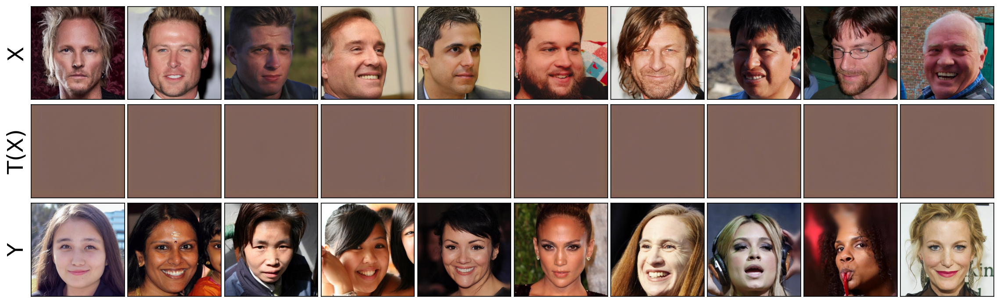

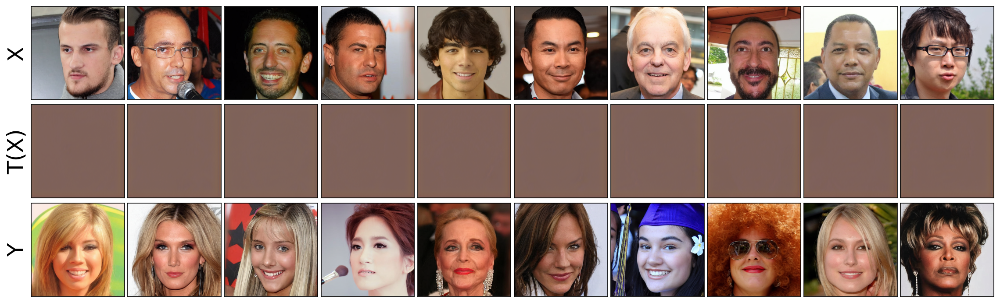

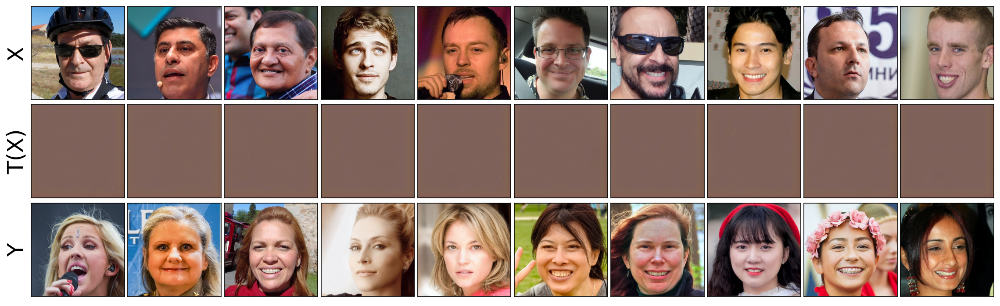

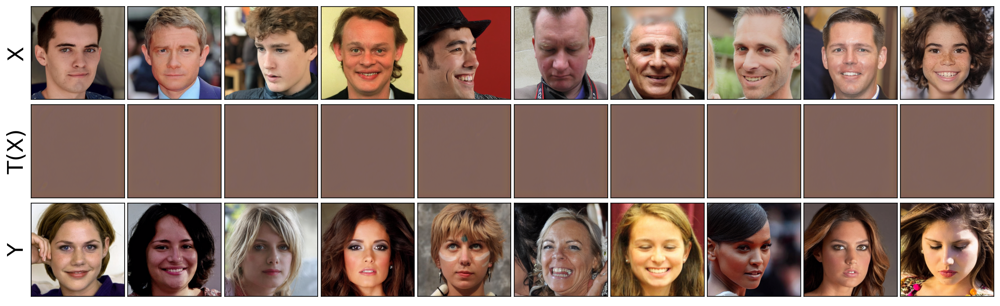

In [9]:
fig, axes = plot_images_from_latent(X_fixed, Y_fixed, T)
fig, axes = plot_random_images_from_latent(X_sampler, Y_sampler, T)
fig, axes = plot_images_from_latent(X_test_fixed, Y_test_fixed, T)
fig, axes = plot_random_images_from_latent(X_test_sampler, Y_test_sampler, T)

In [10]:
user = "krv-valentin"
#wandb.login(relogin=True)
wandb.init(name=EXP_NAME, project='NOT_big_latent_space', entity='krv-valentin', config=config)
pass

/home/user/conda/lib/python3.7/site-packages/notebook/utils.py:282: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  return LooseVersion(v) >= LooseVersion(check)
wandb: Currently logged in as: krv-valentin. Use `wandb login --relogin` to force relogin


In [11]:
T_opt = torch.optim.Adam(T.parameters(), lr=T_LR, weight_decay=1e-10)
f_opt = torch.optim.Adam(f.parameters(), lr=f_LR, weight_decay=1e-10)

In [ ]:
!df -h .

wandb: ERROR Error while calling W&B API: permission denied (<Response [403]>)


In [12]:
scaler_T = torch.cuda.amp.GradScaler()
scaler_f = torch.cuda.amp.GradScaler()

T_scheduler = torch.optim.lr_scheduler.MultiStepLR(
    T_opt, 
    milestones=[10000 * T_ITERS,
                20000 * T_ITERS, 
                35000 * T_ITERS,
                50000 * T_ITERS, 
                70000 * T_ITERS
               ], gamma=0.5
)
f_scheduler = torch.optim.lr_scheduler.MultiStepLR(
    f_opt, 
    milestones=[10000, 20000, 35000, 50000, 70000], gamma=0.5
)

In [14]:
from glob import glob

checkpoint = glob('/home/jovyan/checkpoints_latent/*/*/*.pt')

In [15]:
checkpoint = torch.load(checkpoint[-1])

In [24]:
T.load_state_dict(checkpoint['T_state_dict'])
f.load_state_dict(checkpoint['f_state_dict'])
T_opt.load_state_dict(checkpoint['T_opt'])
f_opt.load_state_dict(checkpoint['f_opt'])
T_scheduler.load_state_dict(checkpoint['T_scheduler'])
f_scheduler.load_state_dict(checkpoint['f_scheduler'])

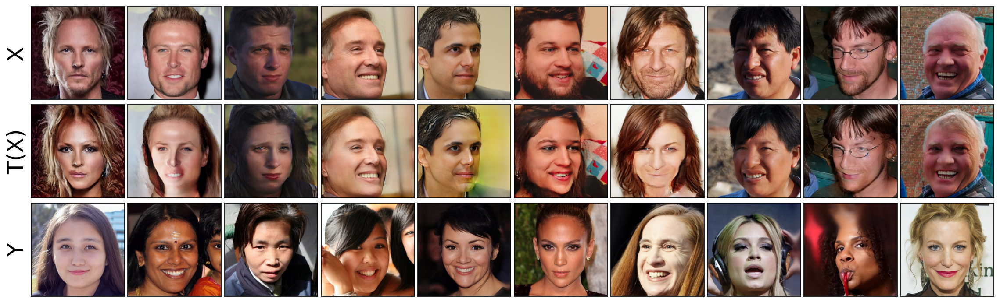

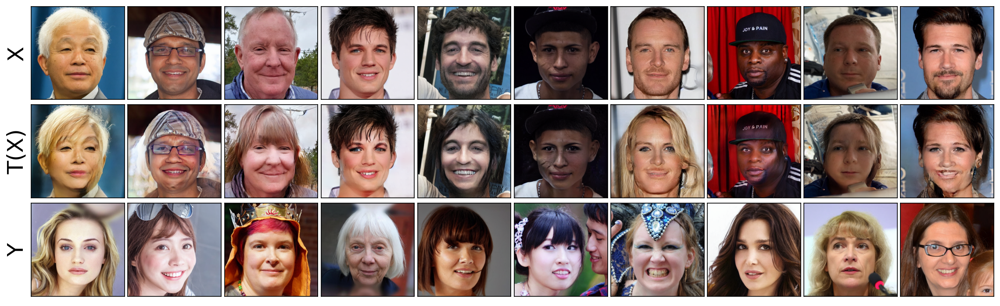

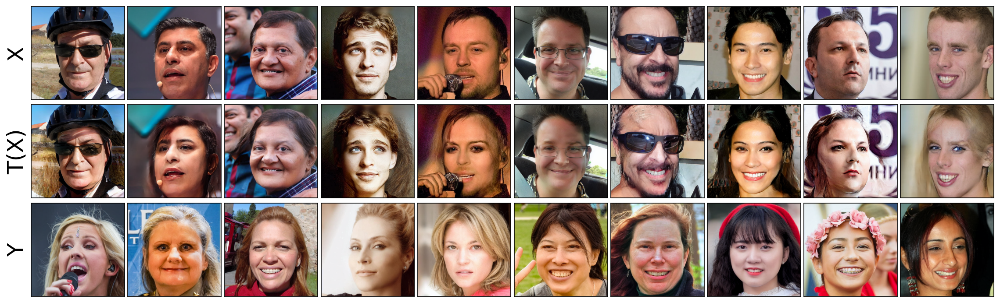

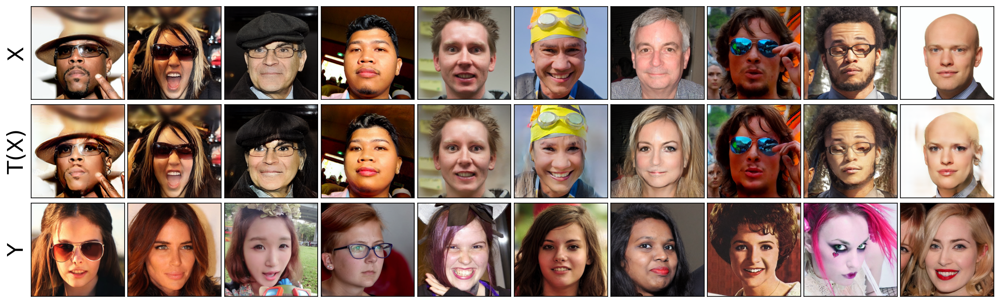

In [ ]:
torch.backends.cudnn.benchmark = True

import time
step_times = [0.7]

for step in tqdm(range(MAX_STEPS)):
    # T optimization

    print(f'{step}/{MAX_STEPS}, sec per step: {np.mean(step_times):.3f}', end='\r')
    start = time.time()
    if len(step_times) > 1000:
        step_times = [step_times[-1]]
    
    unfreeze(T); freeze(f)
    with torch.cuda.amp.autocast():
        for t_iter in range(T_ITERS): 
            T_opt.zero_grad()
            X = X_sampler.sample(BATCH_SIZE)

            T_X = T(X)
            if COST == 'mse':
                T_loss = F.mse_loss(X, T_X).mean() - f(T_X).mean()
            else:
                raise Exception('Unknown COST')
            scaler_T.scale(T_loss).backward()
            scaler_T.step(T_opt)
            scaler_T.update()
            T_scheduler.step()
        #del T_loss, T_X, X; gc.collect(); torch.cuda.empty_cache()

        # f optimization
        freeze(T); unfreeze(f)
        X = X_sampler.sample(BATCH_SIZE)

        with torch.no_grad():
            T_X = T(X)
        Y = Y_sampler.sample(BATCH_SIZE)

        f_opt.zero_grad()
        f_loss = f(T_X).mean() - f(Y).mean()
        scaler_f.scale(f_loss).backward()
        scaler_f.step(f_opt)
        scaler_f.update()
        f_scheduler.step()
        wandb.log({f'f_loss' : f_loss.item()}, step=step) 
        #del f_loss, Y, X, T_X; gc.collect(); torch.cuda.empty_cache()
        
    end = time.time()
    step_times.append(end - start)
    
        
    if step % PLOT_INTERVAL == 0:
        print('Plotting')
        clear_output(wait=True)
        
        fig, axes = plot_images_from_latent(X_fixed, Y_fixed, T)
        wandb.log({'Fixed Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
        fig, axes = plot_random_images_from_latent(X_sampler,  Y_sampler, T)
        wandb.log({'Random Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
        fig, axes = plot_images_from_latent(X_test_fixed, Y_test_fixed, T)
        wandb.log({'Fixed Test Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
        fig, axes = plot_random_images_from_latent(X_test_sampler, Y_test_sampler, T)
        wandb.log({'Random Test Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
    
    if step % CPKT_INTERVAL == CPKT_INTERVAL - 1:
        freeze(T); 
        
        print('Computing FID')
        mu, sigma = get_pushed_loader_stats_from_latent(T, X_test_sampler.loader)
        fid = calculate_frechet_distance(mu_data, sigma_data, mu, sigma)
        wandb.log({f'FID (Test)' : fid}, step=step)
        del mu, sigma
        
        torch.save({
            'step': step,
            'T_state_dict': T.state_dict(),
            'f_state_dict': f.state_dict(),
            'T_opt': T_opt.state_dict(),
            'f_opt': f_opt.state_dict(),
            'T_scheduler': T_scheduler.state_dict(),
            'f_scheduler': f_scheduler.state_dict(),
            }, os.path.join(OUTPUT_PATH, f'img_{SEED}_{step}_strong.pt'))
    
    gc.collect(); torch.cuda.empty_cache()